# Out Of Season Detection in Flood Exposure Monitoring

In [1]:
# Might also need to install
# %pip install jupyter_black
# %pip install nbformat>=4.2.0

%load_ext jupyter_black
%load_ext autoreload
%autoreload 2

In [ ]:
import pandas as pd
import ocha_stratus as stratus  # need v 0.1.5
from dotenv import load_dotenv
import numpy as np
import matplotlib.pyplot as plt

load_dotenv()

ADM_LEVEL = 2
engine = stratus.get_engine("dev")

## Looking at the data

The app displays near real time and historical flood exposure data per admin boundary in selected countries across Africa. This data is updated daily in the `app.floodscan_exposure` table on Postgres and is the source that you'll want to use when coming up with a new visualization.

- `iso3`: Country ISO3 code
- `adm_level`: Admin level (useful for filtering, since we only display one admin level at once)
- `valid_date`: The date that the flood exposure value applies to
- `pcode`: The pcode of the admin unit. Use this as a join field to the geospatial data for any mapping
- `sum`: The sum of flood exposed people in that admin unit for that day. To smooth out noise, we display a rolling sum across N number of days. N defaults to 7 or can otherwise be set to a `ROLL_WINDOW` environment variable. 

In [3]:
with engine.connect() as conn:
    df_nga = pd.read_sql(
        """
        SELECT * FROM app.floodscan_exposure 
        WHERE iso3 = 'NGA'
        """,
        con=conn,
    )

df_nga["year"] = pd.to_datetime(df_nga["valid_date"]).dt.year
df_nga

,iso3,adm_level,valid_date,pcode,sum,year
0,NGA,2,2016-10-07,NG012016,0.0,2016
1,NGA,2,2016-10-07,NG012017,0.0,2016
2,NGA,2,2016-10-07,NG012018,0.0,2016
3,NGA,2,2016-10-07,NG013001,0.0,2016
4,NGA,2,2016-10-07,NG013002,0.0,2016
...,...,...,...,...,...,...
8016871,NGA,2,2016-10-07,NG012011,0.0,2016
8016872,NGA,2,2016-10-07,NG012012,0.0,2016
8016873,NGA,2,2016-10-07,NG012013,0.0,2016
8016874,NGA,2,2016-10-07,NG012014,0.0,2016


Let's focus on Adamawa state in Nigeria - Admin Level 2.

In [4]:
adamawa_pcode = "NG002"

# Filter for adm_level 2 and pcode starting with Adamawa pcode
df_adamawa_adm2 = df_nga[
    (df_nga["pcode"].str.startswith(adamawa_pcode))
    & (df_nga["adm_level"] == 2)
].copy()

print(f"Found {len(df_adamawa_adm2['pcode'].unique())} regions in Adamawa")

Found 21 regions in Adamawa


## Out-of-Season Detection Methodology

Starting from the **pcode level**, we calculate a **5-day rolling sum** of exposed population for each year, then identify periods where exposure is consistently zero across years.

### Parameters

- **`PERCENTAGE_THRESHOLD`** = 99%  
  Minimum percentage of years with zero exposure

- **`CONTEXT_WINDOW_DAYS`** = 30 days  
  Temporal context window (±30 days around each day)

- **`MIN_OOS_CLUSTER_LENGTH`** = 30 days  
  Minimum length for valid OOS periods

### How It Works

1. **Calculate Zero-Exposure Frequency**  
   For each `(pcode, day of year)`, calculate the percentage of years with zero exposure.  
   *Example: If January 15th had 0 people exposed in 18 out of 20 years → 90% zero-exposure rate.*

2. **Apply Temporal Smoothing**  
   Average the zero-percentage within a ±30 day window:  
   `context_zero_pct = mean(zero_pct in [day - 30, day + 30])`

3. **Classify OOS Days**  
   A day is **Out of Season (OOS)** if `context_zero_pct ≥ 99%`

4. **Filter Short Periods**  
   Remove OOS periods shorter than 30 days. Only substantial continuous periods are retained.

In [14]:
from utils.oos_detection import (
    calculate_context_zero_pct,
    filter_short_oos_periods,
)

# ==================== GLOBAL PARAMETERS ====================
PERCENTAGE_THRESHOLD = 99
CONTEXT_WINDOW_DAYS = 30
MIN_OOS_CLUSTER_LENGTH = 30
ROLLING_SUM_DAYS = 5
# ===========================================================

# Prepare the dataframe (assuming df_adamawa_adm2 is your input)
df = df_adamawa_adm2.copy()

# Calculate rolling sum
df["year"] = pd.to_datetime(df["valid_date"]).dt.year
df = df.sort_values(by=["pcode", "year", "valid_date"])
df["rolling_sum_5day"] = df.groupby(["pcode", "year"])["sum"].transform(
    lambda x: x.rolling(window=ROLLING_SUM_DAYS, min_periods=1).sum()
)

# Extract month-day
df["month_day"] = pd.to_datetime(df["valid_date"]).dt.strftime("%m-%d")

# Calculate zero percentage for each pcode-month_day
zero_pct_data = (
    df.groupby(["pcode", "month_day"])["rolling_sum_5day"]
    .apply(lambda x: (x == 0).sum() / len(x) * 100)
    .reset_index()
)
zero_pct_data.columns = ["pcode", "month_day", "zero_pct"]
zero_pct_data = zero_pct_data.sort_values(["pcode", "month_day"])

# Calculate context zero percentage for each pcode
context_results = []
for pcode in zero_pct_data["pcode"].unique():
    pcode_group = zero_pct_data[zero_pct_data["pcode"] == pcode]
    pcode_result = calculate_context_zero_pct(
        pcode_group, window=CONTEXT_WINDOW_DAYS
    )
    context_results.append(pcode_result)

context_data = pd.concat(context_results, ignore_index=True)

# Classify as out of season
context_data["is_out_of_season_raw"] = (
    context_data["context_zero_pct"] >= PERCENTAGE_THRESHOLD
)

# Filter short OOS periods for each pcode
filtered_oos = []
for pcode in context_data["pcode"].unique():
    pcode_data = (
        context_data[context_data["pcode"] == pcode]
        .sort_values("month_day")
        .copy()
    )
    pcode_data["is_out_of_season"] = filter_short_oos_periods(
        pcode_data["is_out_of_season_raw"], min_length=MIN_OOS_CLUSTER_LENGTH
    )
    filtered_oos.append(pcode_data)

stats_final = pd.concat(filtered_oos, ignore_index=True)
stats_final

,pcode,month_day,zero_pct,context_zero_pct,is_out_of_season_raw,is_out_of_season
0,NG002001,01-01,100.0,99.645844,True,True
1,NG002001,01-02,100.0,99.586107,True,True
2,NG002001,01-03,100.0,99.526370,True,True
3,NG002001,01-04,100.0,99.466633,True,True
4,NG002001,01-05,100.0,99.406895,True,True
...,...,...,...,...,...,...
7681,NG002021,12-27,100.0,100.000000,True,True
7682,NG002021,12-28,100.0,100.000000,True,True
7683,NG002021,12-29,100.0,100.000000,True,True
7684,NG002021,12-30,100.0,100.000000,True,True


### Visually inspect out of season likelihood

- **Blue line**: Context zero percentage (averaged over ±30 days) – reveals seasonal patterns throughout the year
- **Red dashed line**: 99% threshold for OOS classification
- **Red shaded areas**: Valid OOS periods (≥30 consecutive days)
- **Yellow shaded areas**: Periods filtered out for being too short (<30 days)

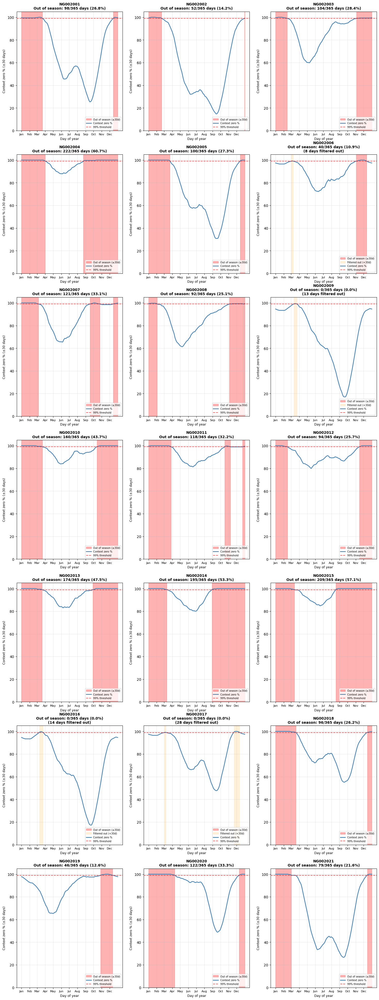

In [17]:
# Visualize OOS detection
pcodes = stats_final["pcode"].unique()
n_pcodes = len(pcodes)

n_cols = 3
n_rows = int(np.ceil(n_pcodes / n_cols))

fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 7 * n_rows), dpi=100)
axes = axes.flatten() if n_pcodes > 1 else [axes]

for idx, pcode in enumerate(pcodes):
    ax = axes[idx]

    pcode_data = stats_final[stats_final["pcode"] == pcode].sort_values(
        "month_day"
    )

    # Create x-axis values
    x = range(len(pcode_data))

    # Add red transparent mask for out of season periods (after filtering)
    out_of_season_mask = pcode_data["is_out_of_season"].values
    ax.fill_between(
        x,
        0,
        105,
        where=out_of_season_mask,
        alpha=0.3,
        color="red",
        label=f"Out of season (≥{MIN_OOS_CLUSTER_LENGTH}d)",
    )

    # Show filtered out periods in lighter color
    filtered_out_mask = (
        pcode_data["is_out_of_season_raw"].values
        & ~pcode_data["is_out_of_season"].values
    )
    if filtered_out_mask.any():
        ax.fill_between(
            x,
            0,
            105,
            where=filtered_out_mask,
            alpha=0.15,
            color="orange",
            label=f"Filtered out (<{MIN_OOS_CLUSTER_LENGTH}d)",
        )

    # Plot context zero percentage (on top of the mask)
    ax.plot(
        x,
        pcode_data["context_zero_pct"],
        linewidth=2,
        color="steelblue",
        label="Context zero %",
        zorder=3,
    )

    # Add threshold line (dashed red)
    ax.axhline(
        PERCENTAGE_THRESHOLD,
        color="red",
        linestyle="--",
        linewidth=1.5,
        alpha=0.7,
        label=f"{PERCENTAGE_THRESHOLD}% threshold",
        zorder=4,
    )

    # Count out of season days
    n_out_of_season = pcode_data["is_out_of_season"].sum()
    n_filtered = pcode_data["is_out_of_season_raw"].sum() - n_out_of_season
    pct_out_of_season = n_out_of_season / len(pcode_data) * 100

    title = f"{pcode}\nOut of season: {n_out_of_season}/365 days ({pct_out_of_season:.1f}%)"
    if n_filtered > 0:
        title += f"\n({n_filtered} days filtered out)"

    ax.set_title(title, fontsize=10, fontweight="bold")
    ax.set_xlabel("Day of year", fontsize=9)
    ax.set_ylabel(f"Context zero % (±{CONTEXT_WINDOW_DAYS} days)", fontsize=9)
    ax.set_ylim([0, 105])
    ax.legend(fontsize=7, loc="lower right")
    ax.grid(True, alpha=0.3, zorder=1)

    # Add month labels
    month_positions = [0, 31, 59, 90, 120, 151, 181, 212, 243, 273, 304, 334]
    month_labels = [
        "Jan",
        "Feb",
        "Mar",
        "Apr",
        "May",
        "Jun",
        "Jul",
        "Aug",
        "Sep",
        "Oct",
        "Nov",
        "Dec",
    ]
    ax.set_xticks(month_positions)
    ax.set_xticklabels(month_labels, fontsize=8)

# Hide extra subplots
for idx in range(n_pcodes, len(axes)):
    axes[idx].set_visible(False)

plt.show()

## Can we find the optimal parameters?

### Problem Statement

Given a continuous time series $y(x) \in [0,1]$ representing daily probabilities 
for $x \in \{1, 2, \ldots, 365\}$, we apply a segmentation algorithm that produces a 
binary output $s(x) \in \{0,1\}$ through:

1. **Smoothing**: $\bar{y}(x) = \text{mean}(y[x-w : x+w])$
2. **Thresholding**: $s(x) = \begin{cases} 1 & \text{if } \bar{y}(x) > \theta \\ 0 & \text{otherwise} \end{cases}$
3. **Run Length Filtering**: Runs with length $< L_{\min}$ are rejected (set to 0)

where:
- $\theta$ is the probability threshold
- $w$ is the window size (in days)
- $L_{\min}$ is the minimum run length (default: 15 or 30 days)

The algorithm generates **runs** (contiguous sequences of 1s), representing 
Out-of-Season (OOS) periods. Different parameter combinations $(\theta, w)$ produce 
different segmentations with varying:
- Number of runs ($k$)
- Run lengths and internal homogeneity
- Temporal gaps between runs


In [18]:
import utils.oos_detection as oos_detection
from dotenv import load_dotenv

load_dotenv()

# ==================== PARAMETER GRID ====================
oos_detection.PERCENTAGE_GRID = [80, 85, 90, 95, 99]
oos_detection.WINDOW_DAYS_GRID = [10, 15, 20, 25, 30]
oos_detection.ADM_LEVEL_GRID = [0, 1, 2]
oos_detection.MIN_OOS_RUN_LENGTH_GRID = [15, 30]
# =======================================================

oos_detection.run_parameter_grid_search(
    container="dev",
    rolling_sum_days=5,
    output_dir="grid_search_results",
    max_workers=16,
)

Total combinations: 150


Grid Search: 100%|██████████| 150/150 [00:00<00:00, 582.69it/s]


Completed! Results saved in: grid_search_results/


## Which is the best model configuration? 

This is a **model selection problem**: each configuration $(\theta, w)$ defines a 
distinct segmentation model $M_{\theta,w}$.

**Goal**: Select the model that optimally balances:
1. **Internal Cohesion**: Days within each OOS run should have similar (high) probability values
2. **Model Parsimony**: Avoid over-segmentation (too many short runs)
3. **Structural Validity**: Each run must span at least $L_{\min}$ consecutive days

We use BIC (Bayesian Information Criterion) to penalize both **poor fit** and **excessive complexity**:

$$
BIC = k \cdot \ln(n) + n \cdot \ln\left(\frac{SS_W}{n}\right)
$$

**Lower BIC is better.** 

### Components

- **$k$** = Number of valid runs (≥ $L_{\min}$ days)
  - Measures model complexity; larger $k$ increases penalty
  
- **$n$** = Total days across all valid runs
  $$n = \sum_{i=1}^{k} |R_i|$$
  
- **$SS_W$** = Within-run sum of squares
  $$SS_W = \sum_{i=1}^{k} \sum_{j \in R_i} \left(y(j) - \bar{y}_i\right)^2$$
  - Lower $SS_W$ means stable probabilities within runs (good cohesion)
  - Higher $SS_W$ means high variability (poor cohesion)

where $\bar{y}_i$ is the mean probability for run $i$, and $y(j)$ is the probability value for day $j$.

*Note: A variance floor of $10^{-10}$ is applied when $SS_W \approx 0$ for numerical stability.*

In [2]:
from utils.oos_validation import run_comprehensive_bic_analysis

run_comprehensive_bic_analysis()

Processing adm_level=0, length=15...
  ✗ Skipped: No parameter combinations with valid BIC for adm_level=0, length=15

Processing adm_level=0, length=30...
  ✗ Skipped: No parameter combinations with valid BIC for adm_level=0, length=30

Processing adm_level=1, length=15...
  ✓ Best config: threshold=99%, window=25 days, median BIC=-251.39, avg BIC=-330.28

Processing adm_level=1, length=30...
  ✓ Best config: threshold=99%, window=20 days, median BIC=-274.64, avg BIC=-594.51

Processing adm_level=2, length=15...
  ✓ Best config: threshold=99%, window=15 days, median BIC=-600.42, avg BIC=-1706.22

Processing adm_level=2, length=30...
  ✓ Best config: threshold=99%, window=10 days, median BIC=-625.02, avg BIC=-1812.71



,adm_level,length,percentage_threshold,context_window_days,median_BIC,avg_BIC
0,2,30,99,10,-625.016273,-1812.712999
1,2,15,99,15,-600.419530,-1706.217849
2,1,30,99,20,-274.643760,-594.514806
3,1,15,99,25,-251.385598,-330.284666


OOS detection failed at the national level (**admin 0**). At such large geographic scales, national aggregation **masks local seasonal patterns**, making the probability of observing zero exposed population negligible. We therefore focus on **admin levels 1 and 2**.

At these levels, all successful configurations converged on **threshold = 99%**, confirming that only days with very high probability should be classified as OOS. However, the optimal context window varies systematically. Two key patterns emerge:

1. **Inverse relationship**: Longer minimum run lengths require shorter context windows (30d → smaller window), suggesting that longer runs are self-validating and need less temporal confirmation.

2. **Mean-median divergence**: Given the substantial gap between mean and median BIC (e.g., -1813 vs -625 for admin 2), we examine the underlying distributions. This divergence signals outlier-driven behavior: certain regions achieve exceptionally low BIC values that pull the mean downward, while most regions perform differently. To understand this pattern, we analyze distribution characteristics (skewness, outlier frequency) and considering prioritizing **median BIC** as our selection criterion. The median represents typical cross-region performance, ensuring our parameter choices work consistently rather than exceptionally well for isolated cases.

In [ ]:
from utils.oos_validation import (
    analyze_bic_grid_search,
    plot_bic_components,
)

# Collect all results
results_dict = {}
for adm_level in [1, 2]:
    for length in [15, 30]:
        results = analyze_bic_grid_search(
            length=length,
            adm_level=adm_level,
            base_folder="grid_search_results",
        )
        results_dict[(adm_level, length)] = results

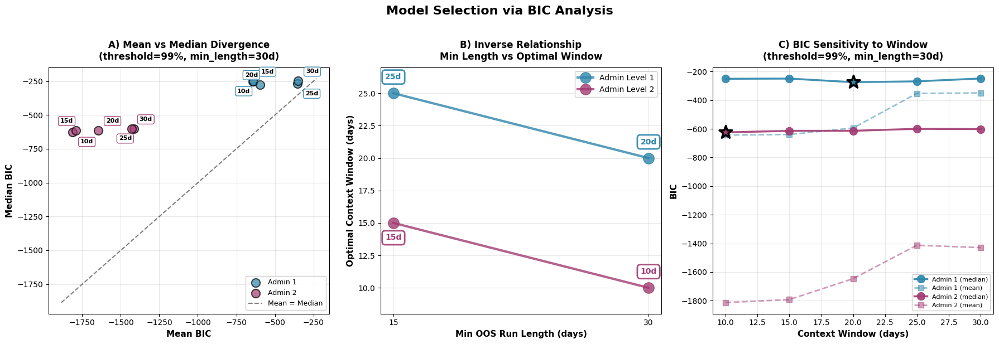

In [20]:
from utils.oos_validation import create_compact_bic_figure

create_compact_bic_figure(results_dict, save_plot=False)

## Discussion

Mean and median BIC diverge clearly (Panel A). Points **above** the diagonal show that mean BIC is more negative than the median, indicating **outlier-driven distributions**: a few regions achieve exceptionally low BIC values that pull the mean downward without reflecting typical behavior. The median therefore provides a more representative performance measure.

Median-based selection reveals a clear **inverse relationship** between run length and window size (Panel B): longer runs (30 days) pair with shorter windows (20d for Admin 1, 10d for Admin 2), while shorter runs (15 days) require wider windows (25d, 15d). This is intuitive—stable OOS periods need less temporal context, whereas shorter periods are more ambiguous and benefit from broader confirmation. Admin Level 2 consistently favors shorter windows, indicating that finer spatial resolution yields clearer local patterns requiring less smoothing.

Sensitivity analysis (Panel C) shows that median BIC (solid lines) varies moderately across window choices, while mean BIC (dashed lines) swings much more, reinforcing the decision to prioritize the median. The relatively flat median curves—especially for Admin Level 2—suggest that window choice matters less when local structures are already distinct.

**Final selection** therefore uses `min_length = 30` days, because (1) median BIC is consistently better at this threshold and (2) longer runs provide greater **specificity**, filtering out transient fluctuations and preserving only substantial OOS periods suitable for operational decisions.

Accordingly, we select:

* **Admin Level 1:** 99% threshold, **20-day** context window, **30-day** run length
* **Admin Level 2:** 99% threshold, **10-day** context window, **30-day** run length


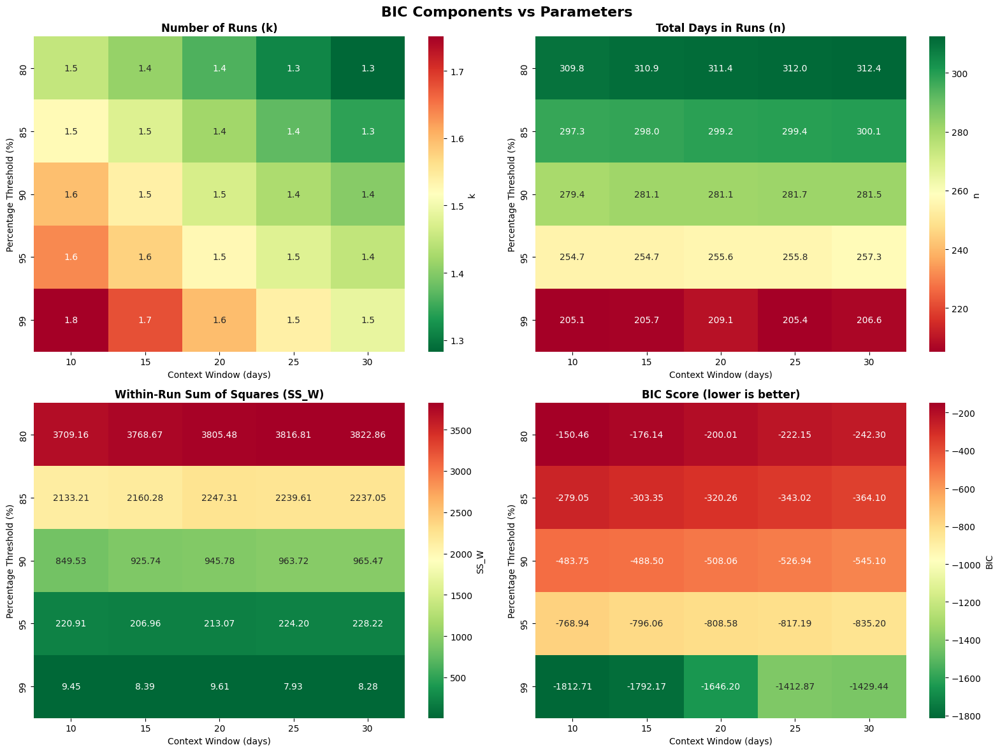

In [23]:
plot_bic_components(
    results_dict[(2, 30)], length=30, admin_level=2, save_plot=False
)

## Old visualization (without OOS detection)

In [ ]:
# These are preprocessed boundaries that take the CODAB shapefiles and simplify and convert to
# geoJSON format so that they're more suitable for web visualization.
import json
import plotly.express as px

from utils.data_utils import get_current_quantiles

load_dotenv()

ADM_LEVEL = 2
engine = stratus.get_engine("prod")

with open(f"assets/geo/adm{ADM_LEVEL}.json", "r") as file:
    data = json.load(file)

# Gets latest data on the quantile assignment of the latest flood exposure values (factoring in a rolling window)
# This is updated in a separate pipeline here:
# https://github.com/OCHA-DAP/ds-floodexposure-monitoring/blob/main/pipelines/update_exposure_quantile.py
df_quantile = get_current_quantiles(ADM_LEVEL)

# This plotting code is different than what's in the app, but it doesn't really matter
fig = px.choropleth_map(
    df_quantile,
    geojson=data,
    locations="pcode",
    color="quantile",
    featureidkey="properties.pcode",
    color_continuous_scale=[
        "#fafafa",
        "#e0e0e0",
        "#b8b8b8",
        "#f7a29c",
        "#da5a51",
    ],
    zoom=3,
)

fig

## New visualization (Out of Season Detection)

In [30]:
# These are preprocessed boundaries that take the CODAB shapefiles and simplify and convert to
# geoJSON format so that they're more suitable for web visualization.

with open(f"assets/geo/adm{ADM_LEVEL}.json", "r") as file:
    data = json.load(file)

oos_days = pd.read_parquet(
    f"./grid_search_results/adm{ADM_LEVEL}/length15/adm2_length15_pct99_win10.parquet"
)

# Gets latest data on the quantile assignment of the latest flood exposure values (factoring in a rolling window)
# This is updated in a separate pipeline here:
# https://github.com/OCHA-DAP/ds-floodexposure-monitoring/blob/main/pipelines/update_exposure_quantile.py
df_quantile = get_current_quantiles(ADM_LEVEL)

oos_days_f = oos_days.loc[
    oos_days["month_day"]
    == str(df_quantile["valid_date"].unique().strftime("%m-%d")[0])
]

df_quantile = df_quantile.merge(
    oos_days_f[["pcode", "is_out_of_season"]], on="pcode"
)

df_quantile.loc[df_quantile["is_out_of_season"] == True, "quantile"] = -3

# This plotting code is different than what's in the app, but it doesn't really matter
fig = px.choropleth_map(
    df_quantile,
    geojson=data,
    locations="pcode",
    color="quantile",
    featureidkey="properties.pcode",
    color_continuous_scale=[
        "#90caf9",  # OUT OF SEASON
        "#fafafa",
        "#e0e0e0",
        "#b8b8b8",
        "#f7a29c",
        "#da5a51",
    ],
    zoom=3,
)

fig

Let's calculate spatial autocorrelation for this day.

In [36]:
from libpysal.weights import Queen
from esda import Moran, Join_Counts
import geopandas as gpd

# ============================================================================
# SPATIAL AUTOCORRELATION ANALYSIS FOR ONE RANDOM DAY
# ============================================================================

results_all = []

for adm in [1, 2]:
    # Load data
    gdf = gpd.read_file(f"assets/geo/adm{adm}.json")
    oos_days = pd.read_parquet(
        f'./grid_search_results/adm{adm}/length30/adm{adm}_length30_pct99_win{"20" if adm==1 else "10"}.parquet'
    )
    df_quantile = get_current_quantiles(adm)
    oos_days_f = oos_days.loc[
        oos_days["month_day"]
        == str(df_quantile["valid_date"].unique().strftime("%m-%d")[0])
    ]
    df_quantile = df_quantile.merge(
        oos_days_f[["pcode", "is_out_of_season"]], on="pcode"
    )
    gdf = gdf.merge(df_quantile[["pcode", "is_out_of_season"]], on="pcode")

    # Spatial weights
    w = Queen.from_dataframe(gdf, use_index=True, silence_warnings=True)
    w.transform = "r"

    # Remove islands
    islands = w.islands
    gdf_conn = gdf[~gdf.index.isin(islands)].copy()
    w_conn = Queen.from_dataframe(
        gdf_conn, use_index=True, silence_warnings=True
    )
    w_conn.transform = "r"

    # Calculate statistics
    gdf_conn["is_oos_binary"] = gdf_conn["is_out_of_season"].astype(int)
    moran = Moran(gdf_conn["is_oos_binary"], w_conn)
    jc = Join_Counts(gdf_conn["is_oos_binary"], w_conn)

    results_all.append(
        {
            "admin_level": adm,
            "n_pcodes": len(gdf_conn),
            "n_islands": len(islands),
            "moran_i": moran.I,
            "p_value": moran.p_sim,
            "z_score": moran.z_sim,
            "bb_joins": jc.bb,
            "bb_expected": jc.mean_bb,
            "bb_excess_pct": ((jc.bb - jc.mean_bb) / jc.mean_bb) * 100,
        }
    )

df_stats = pd.DataFrame(results_all)
df_stats

,admin_level,n_pcodes,n_islands,moran_i,p_value,z_score,bb_joins,bb_expected,bb_excess_pct
0,1,183,0,0.185609,0.003,3.290643,11.0,4.766767,130.764385
1,2,1688,4,0.503527,0.001,29.566300,1356.0,939.936937,44.264998


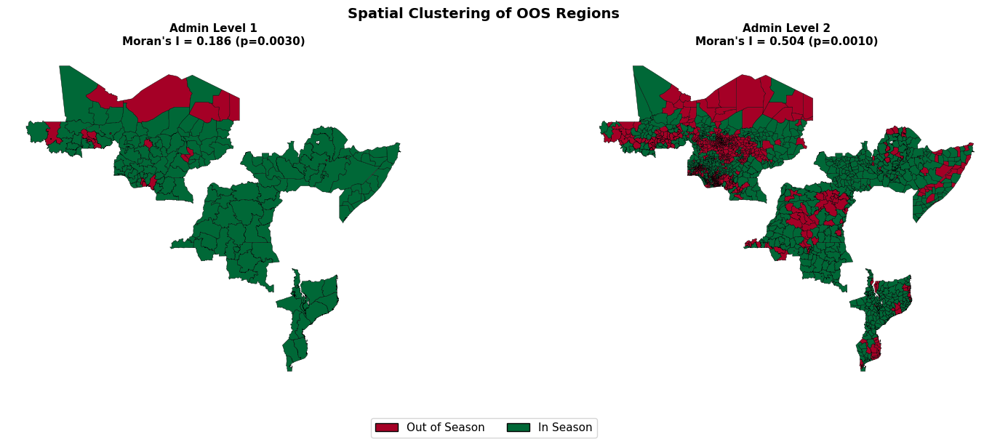

In [37]:
# ============================================================================
# VISUALIZATION
# ============================================================================

fig = plt.figure(figsize=(18, 6))
gs = fig.add_gridspec(1, 2, wspace=0.3)

colors = {1: "#2E86AB", 2: "#A23B72"}

# Panel 1: Maps
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])

for idx, (ax, adm) in enumerate([(ax1, 1), (ax2, 2)]):
    gdf = gpd.read_file(f"assets/geo/adm{adm}.json")
    oos_days = pd.read_parquet(
        f'./grid_search_results/adm{adm}/length30/adm{adm}_length30_pct99_win{"20" if adm==1 else "10"}.parquet'
    )
    df_quantile = get_current_quantiles(adm)
    oos_days_f = oos_days.loc[
        oos_days["month_day"]
        == str(df_quantile["valid_date"].unique().strftime("%m-%d")[0])
    ]
    df_quantile = df_quantile.merge(
        oos_days_f[["pcode", "is_out_of_season"]], on="pcode"
    )
    gdf = gdf.merge(df_quantile[["pcode", "is_out_of_season"]], on="pcode")

    gdf.plot(
        column="is_out_of_season",
        categorical=True,
        ax=ax,
        cmap="RdYlGn_r",
        edgecolor="black",
        linewidth=0.3,
        legend=False,
    )

    moran_val = df_stats[df_stats["admin_level"] == adm]["moran_i"].values[0]
    pval = df_stats[df_stats["admin_level"] == adm]["p_value"].values[0]

    ax.set_title(
        f"Admin Level {adm}\nMoran's I = {moran_val:.3f} (p={pval:.4f})",
        fontsize=11,
        fontweight="bold",
    )
    ax.axis("off")

# Add legend manually
from matplotlib.patches import Patch
import matplotlib.colors as mcolors

cmap = plt.cm.RdYlGn_r
legend_elements = [
    Patch(facecolor=cmap(1.0), edgecolor="black", label="Out of Season"),
    Patch(facecolor=cmap(0.0), edgecolor="black", label="In Season"),
]

fig.legend(
    handles=legend_elements,
    loc="lower center",
    ncol=2,
    fontsize=11,
    frameon=True,
    bbox_to_anchor=(0.5, -0.02),
)

fig.suptitle(
    "Spatial Clustering of OOS Regions", fontsize=14, fontweight="bold"
)

plt.show()